<a href="https://colab.research.google.com/github/leynessa/python_projects/blob/master/tree_census.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##**NYC TREE CENSUS**







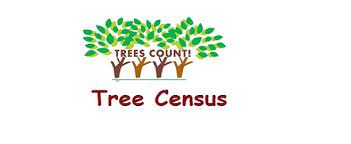

##Problem Statement

---

The goal of the project is to explore the data in the tree census dataset. The project will id the most common tree species and use geopandas to plot theur geolocation on a map od NYC



Dataset

---

This data set is from the NYC OpenData. IT contains data about trees on the street collected in 2015 Street Tree Census, which was conducted by volunteers and staff organized by NYC Parks & Recreation and partner organizations. Tree data collected includes tree species, diameter and perception of health. Accompanying blockface data is available indicating status of data collection and data release citywide. The dataset can be found at: https://data.cityofnewyork.us/Environment/2015-Street-Tree-Census-Tree-Data/uvpi-gqnh

Questions

---

How many different species of trees are there on the streets in NYC in 2016
How many healthy trees?
how many stumps or dead trees?
Where are the trees located ?

Import the relevant libraries and the files

---



In [57]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [58]:
import numpy as py
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from shapely.geometry import Point, Polygon

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
df = pd.read_csv("2015_Street_Tree_Census_-_Tree_Data.csv")


Viewing snipets of data

---



In [59]:
df.head()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough,cncldist,st_assem,st_senate,nta,nta_name,boro_ct,state,latitude,longitude,x_sp,y_sp,council district,census tract,bin,bbl
0,180683,348711,08/27/2015,3,0,OnCurb,Alive,Fair,Acer rubrum,red maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,108-005 70 AVENUE,11375,Forest Hills,406,4,Queens,29,28,16,QN17,Forest Hills,4073900,New York,40.723092,-73.844215,1027431.148,202756.7687,29.0,739.0,4052307.0,4.022210e+09
1,200540,315986,09/03/2015,21,0,OnCurb,Alive,Fair,Quercus palustris,pin oak,None,None,Damage,TreesCount Staff,Stones,Yes,No,No,No,No,No,No,No,No,147-074 7 AVENUE,11357,Whitestone,407,4,Queens,19,27,11,QN49,Whitestone,4097300,New York,40.794111,-73.818679,1034455.701,228644.8374,19.0,973.0,4101931.0,4.044750e+09
2,204026,218365,09/05/2015,3,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,1or2,None,Damage,Volunteer,None,No,No,No,No,No,No,No,No,No,390 MORGAN AVENUE,11211,Brooklyn,301,3,Brooklyn,34,50,18,BK90,East Williamsburg,3044900,New York,40.717581,-73.936608,1001822.831,200716.8913,34.0,449.0,3338310.0,3.028870e+09
3,204337,217969,09/05/2015,10,0,OnCurb,Alive,Good,Gleditsia triacanthos var. inermis,honeylocust,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,1027 GRAND STREET,11211,Brooklyn,301,3,Brooklyn,34,53,18,BK90,East Williamsburg,3044900,New York,40.713537,-73.934456,1002420.358,199244.2531,34.0,449.0,3338342.0,3.029250e+09
4,189565,223043,08/30/2015,21,0,OnCurb,Alive,Good,Tilia americana,American linden,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,603 6 STREET,11215,Brooklyn,306,3,Brooklyn,39,44,21,BK37,Park Slope-Gowanus,3016500,New York,40.666778,-73.975979,990913.775,182202.4260,39.0,165.0,3025654.0,3.010850e+09


View the columns and choosing the relevant columns

In [60]:
df.columns

Index(['tree_id', 'block_id', 'created_at', 'tree_dbh', 'stump_diam',
       'curb_loc', 'status', 'health', 'spc_latin', 'spc_common', 'steward',
       'guards', 'sidewalk', 'user_type', 'problems', 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address', 'postcode',
       'zip_city', 'community board', 'borocode', 'borough', 'cncldist',
       'st_assem', 'st_senate', 'nta', 'nta_name', 'boro_ct', 'state',
       'latitude', 'longitude', 'x_sp', 'y_sp', 'council district',
       'census tract', 'bin', 'bbl'],
      dtype='object')

In [61]:
tree_census_subset = df[['tree_id', 'block_id', 'created_at', 'tree_dbh', 'stump_diam',
       'curb_loc', 'status', 'health', 'spc_latin', 'spc_common', 'steward',
       'guards', 'sidewalk', 'user_type', 'problems', 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address', 'postcode',
       'zip_city', 'community board', 'borocode', 'borough']]

Data **Dictionary**

---
Unique Tree ID Number- tree_id <br>
Date trees were mapped - created_at <br>
Diameter at breast height of tree -tree_dbh <br>
Diameter of stump -stump_diam <br>
Tree Status -status <br>
Tree Health- health <br>
more: file:///C:/Users/leyne/Downloads/StreetTreeCensus2015TreesDataDictionary20161102.pdf


In [62]:
tree_census_subset.columns

Index(['tree_id', 'block_id', 'created_at', 'tree_dbh', 'stump_diam',
       'curb_loc', 'status', 'health', 'spc_latin', 'spc_common', 'steward',
       'guards', 'sidewalk', 'user_type', 'problems', 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address', 'postcode',
       'zip_city', 'community board', 'borocode', 'borough'],
      dtype='object')

In [63]:
tree_census_subset.tail()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
683783,155433,217978,08/18/2015,25,0,OnCurb,Alive,Good,Quercus palustris,pin oak,None,None,Damage,Volunteer,None,No,No,No,No,No,No,No,No,No,32 MARCY AVENUE,11211,Brooklyn,301,3,Brooklyn
683784,183795,348185,08/29/2015,7,0,OnCurb,Alive,Good,Cladrastis kentukea,Kentucky yellowwood,1or2,None,NoDamage,Volunteer,None,No,No,No,No,No,No,No,No,No,67-035 SELFRIDGE STREET,11375,Forest Hills,406,4,Queens
683785,166161,401670,08/22/2015,12,0,OnCurb,Alive,Good,Acer rubrum,red maple,None,None,Damage,Volunteer,None,No,No,No,No,No,No,No,No,No,130 BIDWELL AVENUE,10314,Staten Island,501,5,Staten Island
683786,184028,504204,08/29/2015,9,0,OnCurb,Alive,Good,Acer rubrum,red maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,1985 ANTHONY AVENUE,10457,Bronx,205,2,Bronx
683787,200607,306527,09/03/2015,23,0,OnCurb,Alive,Fair,Acer rubrum,red maple,None,None,NoDamage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,69-069 183 STREET,11365,Fresh Meadows,408,4,Queens


Reviewing missing values

In [64]:
tree_census_subset.isna().sum()

tree_id                0
block_id               0
created_at             0
tree_dbh               0
stump_diam             0
curb_loc               0
status                 0
health             31616
spc_latin          31619
spc_common         31619
steward            31615
guards             31616
sidewalk           31616
user_type              0
problems           31664
root_stone             0
root_grate             0
root_other             0
trunk_wire             0
trnk_light             0
trnk_other             0
brch_light             0
brch_shoe              0
brch_other             0
address                0
postcode               0
zip_city               0
community board        0
borocode               0
borough                0
dtype: int64

In [65]:
#show where health is a nul value
tree_census_subset[tree_census_subset['health'].isna()]

 #dataframe.notna() function detects existing/ non-missing values in the dataframe.

In [17]:
tree_census_subset.describe() #show the numerical values

,tree_id,block_id,tree_dbh,stump_diam
count,178882.000000,178882.000000,178882.000000,178882.000000
mean,274867.853686,310162.274863,11.216103,0.479964
std,62494.727806,125223.829768,8.557613,3.461009
min,7.000000,100002.000000,0.000000,0.000000
25%,228277.250000,218639.000000,4.000000,0.000000
50%,276321.500000,319786.000000,9.000000,0.000000
75%,325057.750000,410084.000000,16.000000,0.000000
max,443757.000000,516318.000000,425.000000,140.000000


In [66]:
tree_census_subset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 683788 entries, 0 to 683787
Data columns (total 30 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   tree_id          683788 non-null  int64 
 1   block_id         683788 non-null  int64 
 2   created_at       683788 non-null  object
 3   tree_dbh         683788 non-null  int64 
 4   stump_diam       683788 non-null  int64 
 5   curb_loc         683788 non-null  object
 6   status           683788 non-null  object
 7   health           652172 non-null  object
 8   spc_latin        652169 non-null  object
 9   spc_common       652169 non-null  object
 10  steward          652173 non-null  object
 11  guards           652172 non-null  object
 12  sidewalk         652172 non-null  object
 13  user_type        683788 non-null  object
 14  problems         652124 non-null  object
 15  root_stone       683788 non-null  object
 16  root_grate       683788 non-null  object
 17  root_other

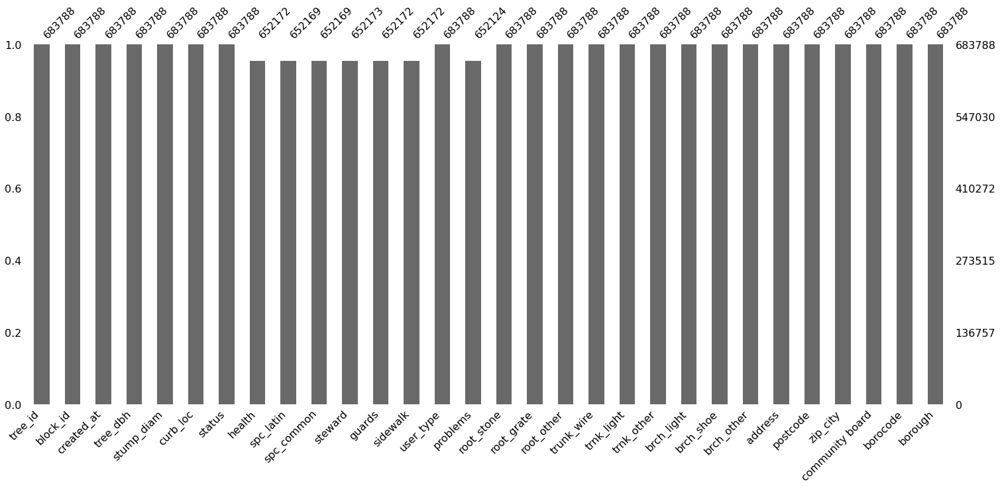

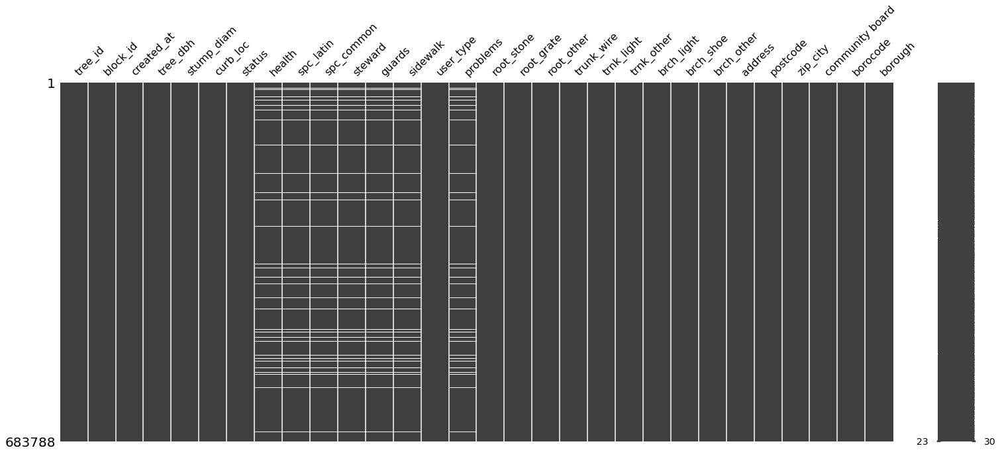

In [67]:
import missingno
missingno.bar(tree_census_subset)
missingno.matrix(tree_census_subset)



array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fecfc0b3130>,
      dtype=object)

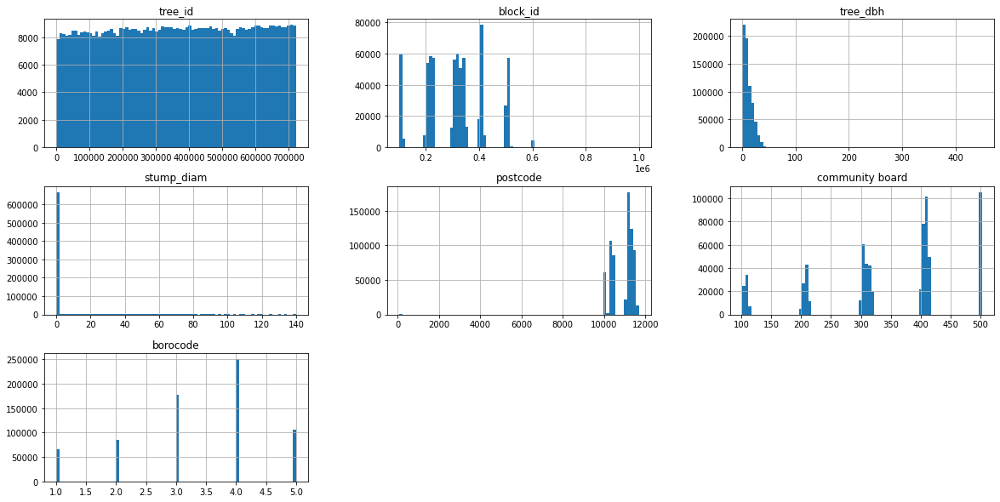

In [68]:
tree_census_subset.hist(bins=80, figsize= (20,10))

In [69]:
#query information about possivel outliers
big_tree = tree_census_subset[tree_census_subset['tree_dbh']>50]
big_tree.tail()

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
675265,179496,322014,08/27/2015,52,0,OffsetFromCurb,Alive,Good,Quercus palustris,pin oak,None,None,Damage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,194-001 37 AVENUE,11358,Flushing,411,4,Queens
677954,166796,348127,08/22/2015,54,0,OnCurb,Alive,Good,Acer saccharinum,silver maple,None,None,NoDamage,Volunteer,Stones,Yes,No,No,No,No,No,No,No,No,111-030 77 ROAD,11375,Forest Hills,406,4,Queens
679894,169501,312374,08/23/2015,51,0,OnCurb,Alive,Good,Quercus alba,white oak,None,None,NoDamage,Volunteer,BranchLights,No,No,No,No,No,No,Yes,No,No,36-040 BOWNE STREET,11354,Flushing,407,4,Queens
681736,179366,349326,08/27/2015,281,0,OnCurb,Alive,Fair,Quercus palustris,pin oak,None,None,Damage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,105-048 63 ROAD,11375,Forest Hills,406,4,Queens
682788,183910,505123,08/29/2015,127,0,OnCurb,Dead,NaN,NaN,NaN,NaN,NaN,NaN,Volunteer,NaN,No,No,No,No,No,No,No,No,No,575 EAST TREMONT AVENUE,10457,Bronx,206,2,Bronx


array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fecf7132640>,
      dtype=object)

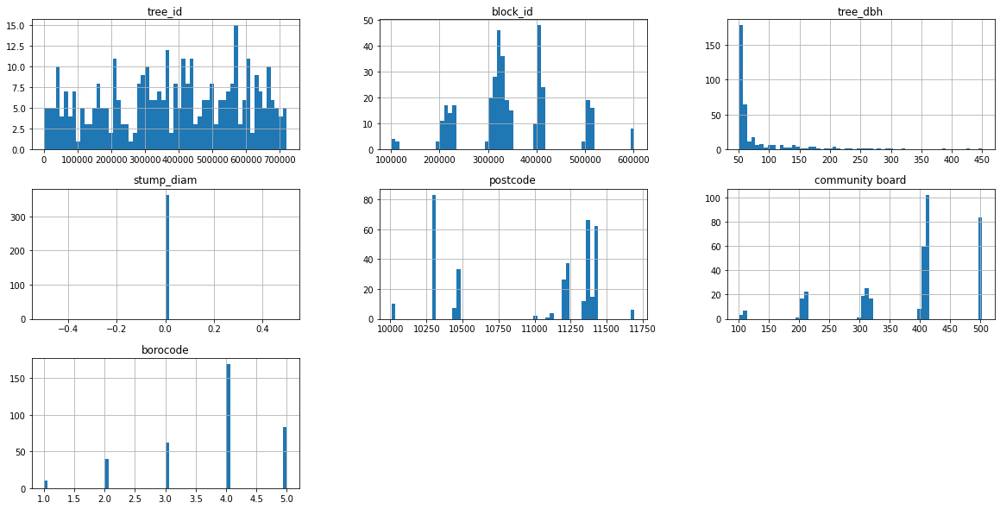

In [70]:
big_tree.hist(bins=60, figsize=(20,10))

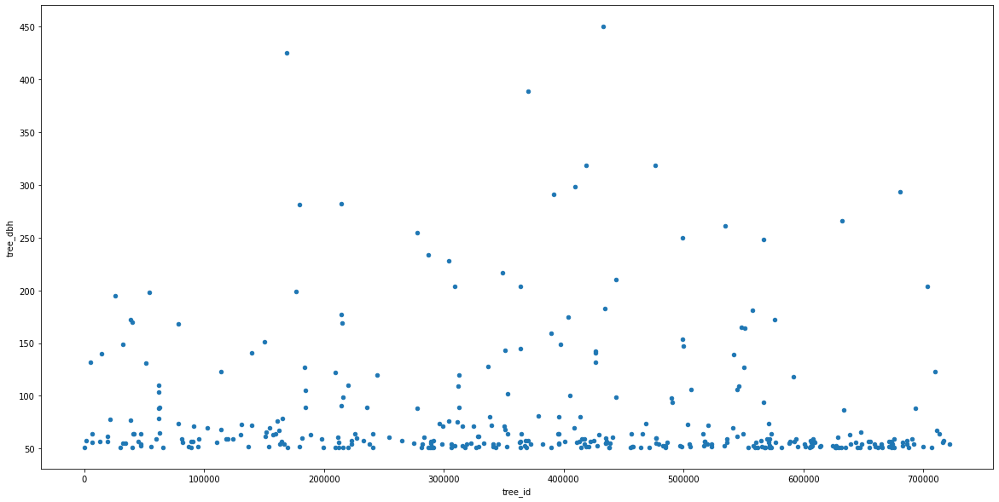

In [71]:
big_tree[['tree_id', 'tree_dbh']].plot(kind = 'scatter', y =  'tree_dbh', x = 'tree_id', figsize=(20,10))

In [72]:
counting=tree_census_subset[[ 'root_stone',
       'root_grate', 'root_other', 'trunk_wire', 'trnk_light', 'trnk_other',
       'brch_light', 'brch_shoe', 'brch_other', 'address']]

In [73]:
counting.apply(pd.Series.value_counts)

In [74]:
tree_census_subset['health'].value_counts()

Good    528850
Fair     96504
Poor     26818
Name: health, dtype: int64

**DATA CLEANING**

In [76]:
mask =( (tree_census_subset['status'] == 'Stump') | ( tree_census_subset['status'] == 'Dead') )

In [77]:
tree_census_subset.loc[mask, 'health'] = tree_census_subset.loc[mask, 'health'].fillna('Not Applicable')

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [ ]:
tree_census_subset[tree_census_subset['status'] == 'Stump']

In [79]:
tree_census_subset.loc[mask] = tree_census_subset.loc[mask].fillna('Not Applicable')

/usr/local/lib/python3.8/dist-packages/pandas/core/indexing.py:1884: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, val, pi)


In [80]:
tree_census_subset[tree_census_subset['status'] == 'Stump']

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
37,211205,302080,09/09/2015,0,16,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,21-023 24 DRIVE,11102,Astoria,401,4,Queens
239,203597,301947,09/04/2015,0,15,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,22-063 37 STREET,11105,Astoria,401,4,Queens
641,179766,230466,08/27/2015,0,30,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,2676 BEDFORD AVENUE,11210,Brooklyn,314,3,Brooklyn
644,180619,348834,08/27/2015,0,10,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,113-001 JEWEL AVENUE,11375,Forest Hills,406,4,Queens
646,208828,107238,09/08/2015,0,15,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,301 EAST 66 STREET,10065,New York,108,1,Manhattan
648,181973,337808,08/28/2015,0,25,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,NYC Parks Staff,Not Applicable,No,No,No,No,No,No,No,No,No,192 BEACH 142 STREET,11694,Rockaway Park,414,4,Queens
739,200522,210288,09/03/2015,0,17,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,1970 COYLE STREET,11229,Brooklyn,315,3,Brooklyn
741,174299,217297,08/25/2015,0,15,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,164 MANHATTAN AVENUE,11206,Brooklyn,301,3,Brooklyn
743,198633,415600,09/02/2015,0,16,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Volunteer,Not Applicable,No,No,No,No,No,No,No,No,No,105 BELFAST AVENUE,10306,Staten Island,503,5,Staten Island
774,209649,503989,09/08/2015,0,5,OnCurb,Stump,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,Not Applicable,TreesCount Staff,Not Applicable,No,No,No,No,No,No,No,No,No,165 EAST 176 STREET,10457,Bronx,205,2,Bronx


In [81]:
tree_census_subset[tree_census_subset['status'] == 'Nan']

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough


In [ ]:
missingno.matrix(tree_census_subset)

In [83]:
tree_census_subset.isna().sum()

tree_id             0
block_id            0
created_at          0
tree_dbh            0
stump_diam          0
curb_loc            0
status              0
health              1
spc_latin           5
spc_common          5
steward             0
guards              1
sidewalk            1
user_type           0
problems           49
root_stone          0
root_grate          0
root_other          0
trunk_wire          0
trnk_light          0
trnk_other          0
brch_light          0
brch_shoe           0
brch_other          0
address             0
postcode            0
zip_city            0
community board     0
borocode            0
borough             0
dtype: int64

In [84]:
tree_census_subset[tree_census_subset['health'].isna()]

,tree_id,block_id,created_at,tree_dbh,stump_diam,curb_loc,status,health,spc_latin,spc_common,steward,guards,sidewalk,user_type,problems,root_stone,root_grate,root_other,trunk_wire,trnk_light,trnk_other,brch_light,brch_shoe,brch_other,address,postcode,zip_city,community board,borocode,borough
32889,245041,413012,09/21/2015,16,0,OnCurb,Alive,NaN,Fraxinus pennsylvanica,green ash,None,None,Damage,TreesCount Staff,None,No,No,No,No,No,No,No,No,No,84 LUCILLE AVENUE,10309,Staten Island,503,5,Staten Island


In [ ]:
tree_census_subset[tree_census_subset['problems'].isna()]

treating missing values

In [86]:
tree_census_subset['problems'].fillna("None", inplace = True)

/usr/local/lib/python3.8/dist-packages/pandas/core/generic.py:6392: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [87]:
tree_census_subset.isna().sum()


tree_id            0
block_id           0
created_at         0
tree_dbh           0
stump_diam         0
curb_loc           0
status             0
health             1
spc_latin          5
spc_common         5
steward            0
guards             1
sidewalk           1
user_type          0
problems           0
root_stone         0
root_grate         0
root_other         0
trunk_wire         0
trnk_light         0
trnk_other         0
brch_light         0
brch_shoe          0
brch_other         0
address            0
postcode           0
zip_city           0
community board    0
borocode           0
borough            0
dtype: int64

In [88]:
tree_census_subset['health'].fillna("Good", inplace = True)

In [89]:
tree_census_subset['spc_latin'].fillna("No Observation", inplace = True)
tree_census_subset['sidewalk'].fillna("NoDamage", inplace = True)
tree_census_subset['spc_common'].fillna("None", inplace = True)
tree_census_subset['guards'].fillna("None", inplace = True)

In [90]:
tree_census_subset.isna().sum()

tree_id            0
block_id           0
created_at         0
tree_dbh           0
stump_diam         0
curb_loc           0
status             0
health             0
spc_latin          0
spc_common         0
steward            0
guards             0
sidewalk           0
user_type          0
problems           0
root_stone         0
root_grate         0
root_other         0
trunk_wire         0
trnk_light         0
trnk_other         0
brch_light         0
brch_shoe          0
brch_other         0
address            0
postcode           0
zip_city           0
community board    0
borocode           0
borough            0
dtype: int64

dealing with outliners

In [ ]:
big_tree = tree_census_subset[(tree_census_subset['tree_dbh']>60) | (tree_census_subset['stump_diam']>60)] 
big_tree

removing the outliers to the mean can be calculated

In [ ]:
tree_census_subset = tree_census_subset[(tree_census_subset['tree_dbh']<=60) & (tree_census_subset['stump_diam']<=60)] 
tree_census_subset

creating diferent dataset for stumps and alive trees because if the tree is alive the diameter is 0

In [52]:
tree_census_subset_alive =tree_census_subset[tree_census_subset['status'] == 'Alive']
tree_census_subset_dead_or_Stump = tree_census_subset[(tree_census_subset['status'] == 'Stump')  | (tree_census_subset['status'] == 'Dead')  ]

Tree Species

---



In [ ]:
#group by tree type
tree_census_subset_alive.groupby('spc_latin').mean()

In [ ]:
tree_census_subset_alive.groupby('spc_latin')['tree_dbh'].describe()

In [ ]:
stats_alive = tree_census_subset_alive.groupby('spc_latin')['tree_dbh' ].describe().reset_index()[['spc_latin', '25%', '75%' ]]
stats_alive

In [56]:
tree_census_subset_alive.merge(stats_alive, on = 'spc_latin', how = 'left')
tree_census_subset_alive

In [ ]:
# normalize tree counts by tree species in each borough
species_counts_boro = []
for b in df.borough.unique().tolist():
    counts = tree_census_subset [tree_census_subset .borough==b].spc_common.value_counts(dropna=True, normalize=True).reset_index()
    counts.columns = ["species", "proportion"]
    species_counts_boro.append(counts)
    print(b)
    display(counts[:10])